
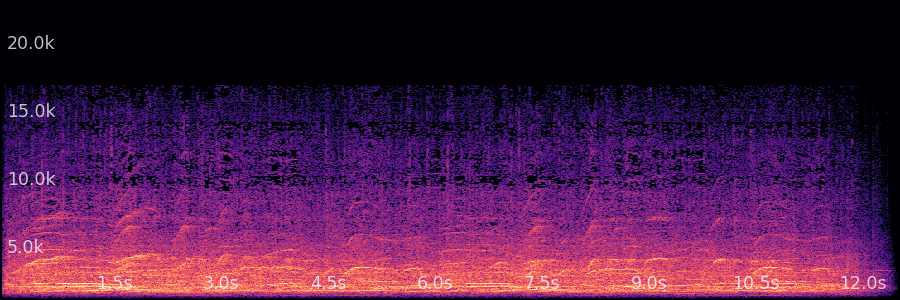
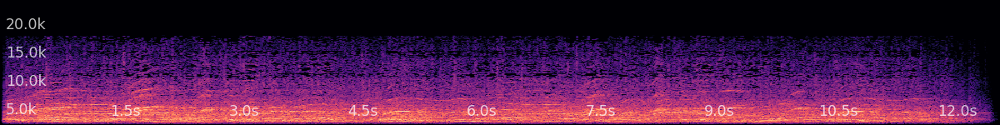


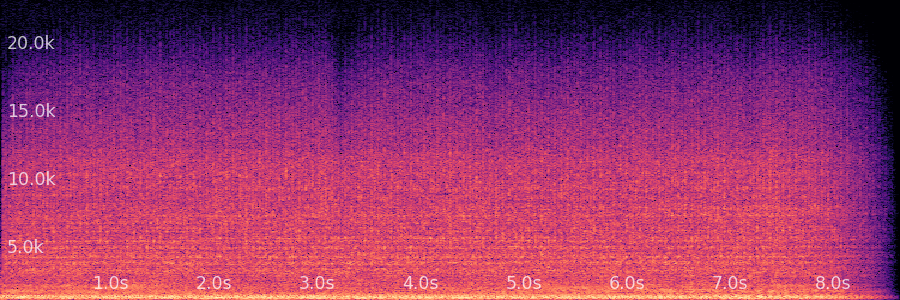
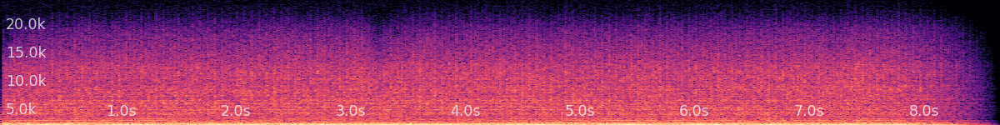

/usr/local/lib/python3.10/dist-packages/audiotools/core/audio_signal.py:601: UserWarning: Audio amplitude > 1 clipped when saving
  warnings.warn("Audio amplitude > 1 clipped when saving")



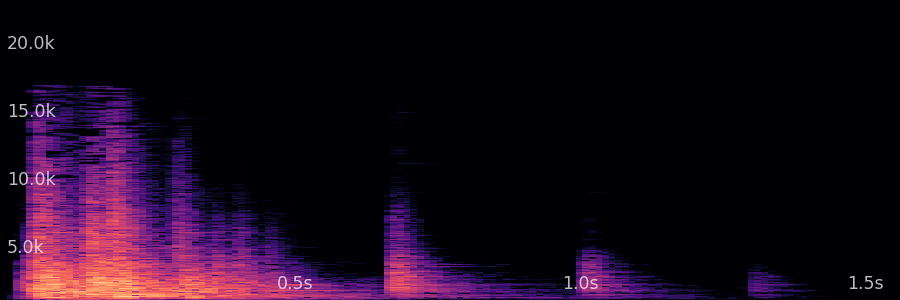
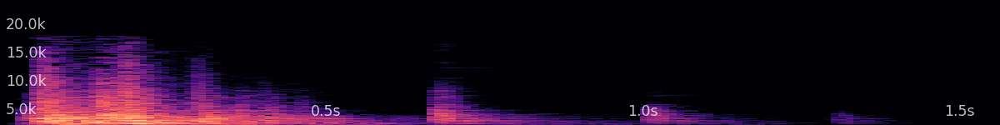


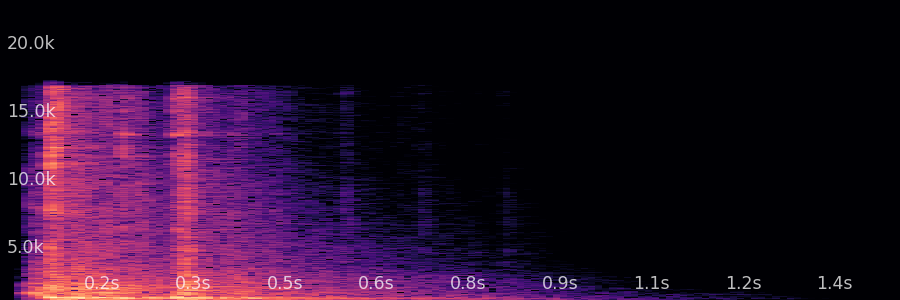
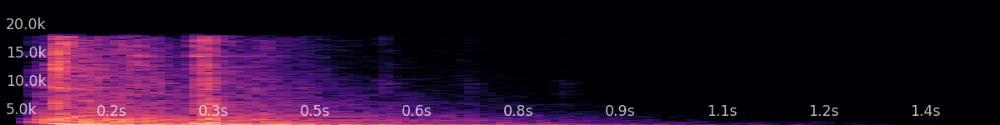


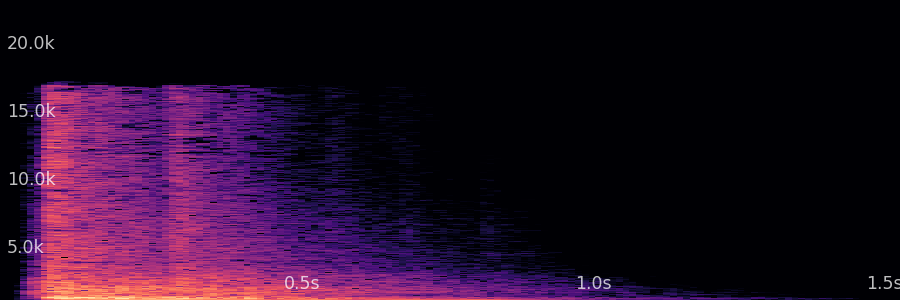
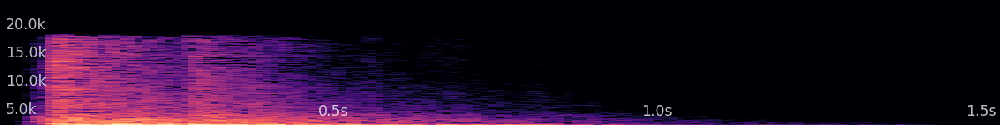

In [236]:
from audiotools import AudioSignal

examples = [
    "./dataset/05_loud applause.mp3",
    "./dataset/1.propellar aircraft sound.wav",
    "./dataset/11_metal door shutting 01.mp3",
    "./dataset/11_metal door shutting 02.mp3",
    "./dataset/11_metal door shutting 03.mp3",
    "./dataset/24.sail flapping on the wind.wav",
    "./dataset/27_cow sound effect.mp3",
    "./dataset/29.cartoon punch sound effect.wav",
]

e0 = AudioSignal(examples[0], sample_rate=16000).to_mono()
e1 = AudioSignal(examples[1], sample_rate=16000).to_mono()
e2 = AudioSignal(examples[2], sample_rate=16000).to_mono()
e3 = AudioSignal(examples[3], sample_rate=16000).to_mono()
e4 = AudioSignal(examples[4], sample_rate=16000).to_mono()

e0.widget()
e1.widget()
e2.widget()
e3.widget()
e4.widget()

In [232]:
from pydub import AudioSegment

audio = AudioSegment.from_file(examples[2])

louder_audio = audio + 10
quieter_audio = audio - 10

# louder_audio.export("path_to_louder_audio_file.mp3", format="mp3")
# quieter_audio.export("path_to_quieter_audio_file.mp3", format="mp3")

e2.audio_data.squeeze().shape

torch.Size([69120])

In [233]:
import torch
import random

EPS = torch.finfo(torch.float32).eps
def pre_process(audio_path, total_duration):
    durad = 3.0
    duration = durad if total_duration >= 3 else total_duration  # Duration is 3 seconds or total_duration if less than 3
    
    if total_duration < durad: # 3초보다 짧으면 그냥 사용
        offset = 0.0
    else:
        # 3초보다 길면 랜덤한 구간에서 3초를 가져와서 사용
        max_offset = total_duration - duration  # Calculate the maximum possible offset
        offset = random.uniform(0, max_offset)  # Choose a random offset within the possible range
    
    # Load audio signal file
    wav = AudioSignal(audio_path, offset=offset, duration=duration)
    length = wav.signal_length

    wav.to_mono()
    wav.resample(16000)

    if wav.duration < durad: # 3초보다 짧으면 패딩으로 채우기
      pad_len = int(durad * 16000) - wav.signal_length
      wav.zero_pad(0, pad_len)
    assert wav.duration <= durad # 3초보다 길면? 안되는데 그러면

    return wav.audio_data, length

def normalize(audio):
    audio = audio/(audio.max(1)[0].abs().unsqueeze(1) + EPS)
    
    rms = (audio**2).mean(1).pow(0.5)
    scalar = 10**(-25/20) / (rms + EPS)
    audio = audio * scalar.unsqueeze(1)

    return audio

In [124]:
wav, length = pre_process(examples[0], e0.duration)
wav = wav.squeeze(1)
wav = normalize(wav)

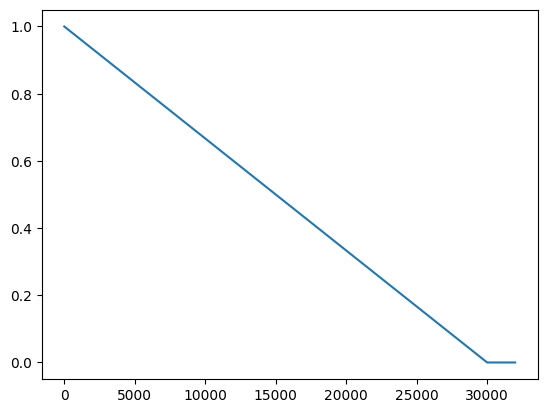

In [136]:
import matplotlib.pyplot as plt
plt.plot(fade_curve)
plt.show()

In [135]:
# Generate a linear fade-out curve (from 1 to 0)
fade_curve = np.concatenate((np.linspace(1, 0, 16000), np.zeros(2000)))

wav2 = wav.clone()
wav2[0][-16000:] = wav2[0][-16000:] * fade_curve


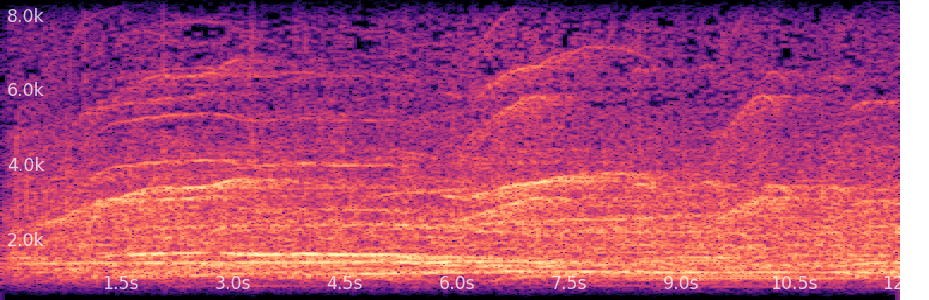
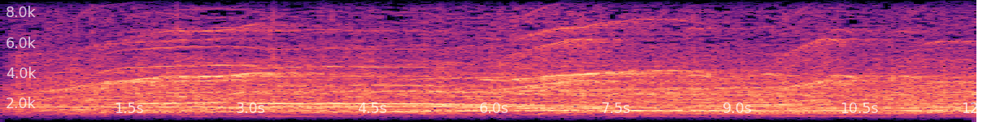


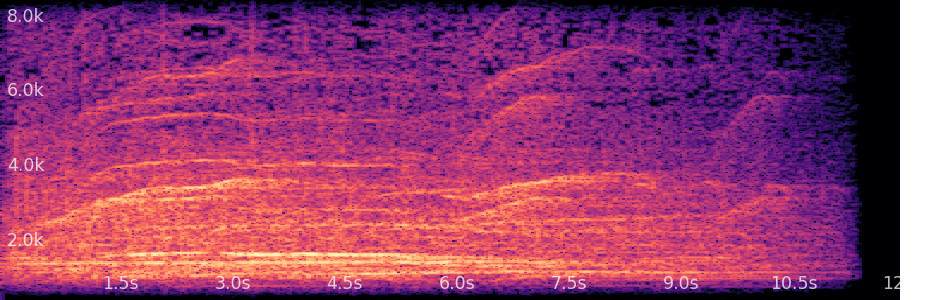
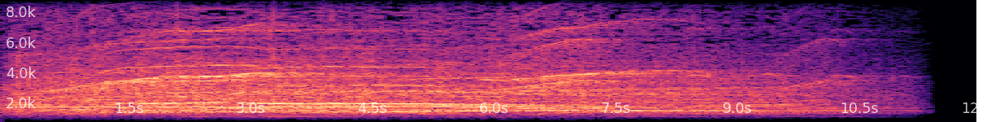


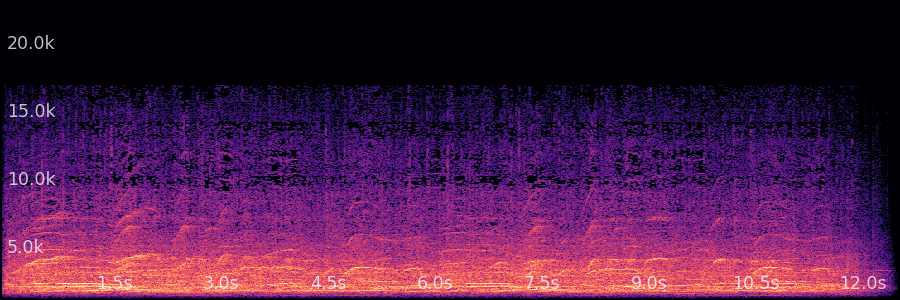
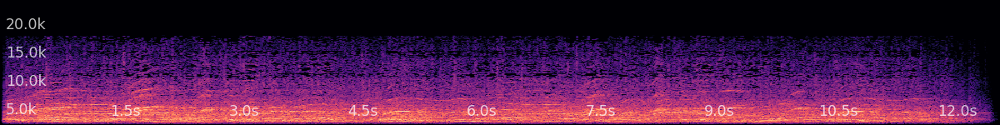

In [137]:
AudioSignal(wav, sample_rate=16000).widget()
AudioSignal(wav2, sample_rate=16000).widget()
e0.widget()

In [144]:
# Import the package and create an audio effects chain function.
from pysndfx import AudioEffectsChain

fx = (
    AudioEffectsChain()
    .highshelf()
    .reverb()
    .phaser()
    .delay()
    .lowshelf()
)

In [147]:
infile = examples[2]
outfile = 'my_processed_audio_file.ogg'

# Apply phaser and reverb directly to an audio file.
# fx(infile, outfile)

# Or, apply the effects directly to a ndarray.
from librosa import load
y, sr = load(infile, sr=None)
y = fx(y)

# # Apply the effects and return the results as a ndarray.
# y = fx(infile)

# # Apply the effects to a ndarray but store the resulting audio to disk.
# fx(x, outfile)


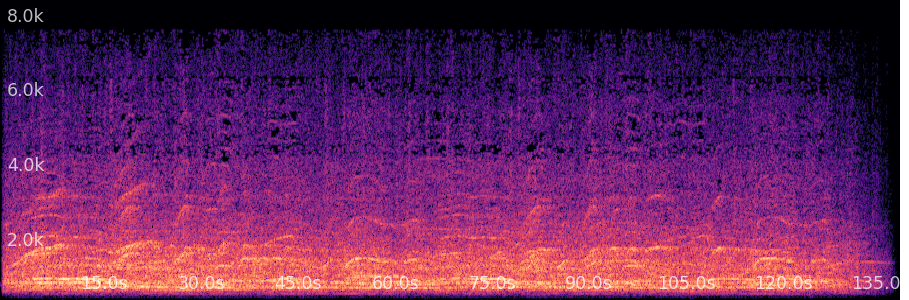
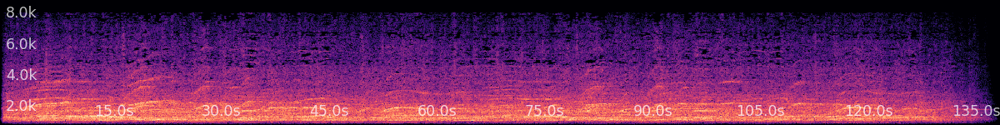


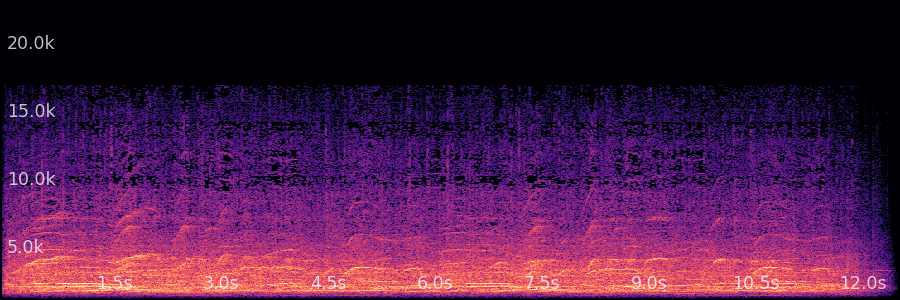
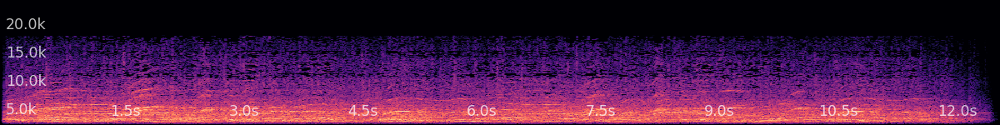

In [161]:
from librosa import load
infile = examples[0]
y, sr = load(infile, sr=None)
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=4)

AudioSignal(y_shifted, sample_rate=16000).widget()
e0.widget()

In [245]:
from pydub import AudioSegment
from numpy.random import uniform
filename = examples[-2]
sound = AudioSegment.from_file(filename, format=filename[-3:])

octaves = 0.5
new_sample_rate = int(sound.frame_rate * (2.0 ** octaves))
print(new_sample_rate)
hipitch_sound = sound._spawn(sound.raw_data, overrides={'frame_rate': new_sample_rate})
hipitch_sound = hipitch_sound.set_frame_rate(44100)

62366


In [246]:
hipitch_sound


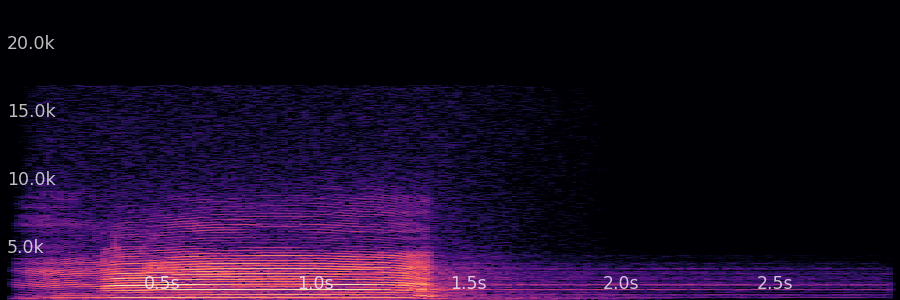
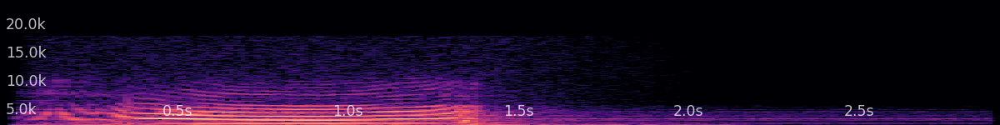

In [247]:
AudioSignal(filename, sample_rate=16000).widget()

In [209]:
wav_3s = AudioSignal(examples[0]).to_mono().resample(16000).audio_data.squeeze(0)
wav_3s.shape

torch.Size([1, 201874])


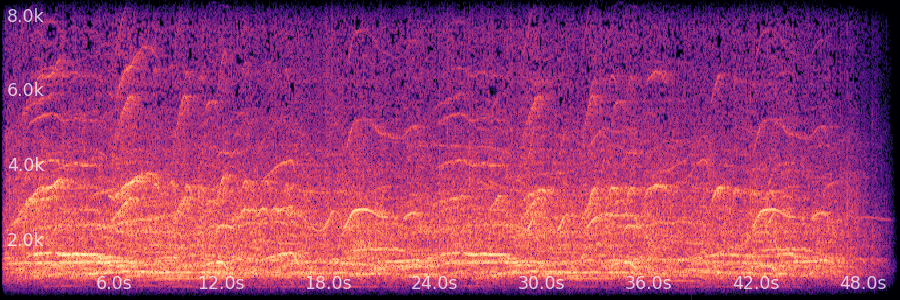
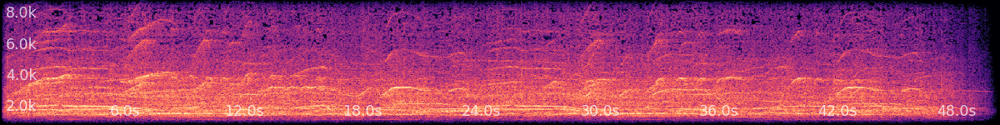

In [210]:
AudioSignal(wav_3s, sample_rate=16000).widget()


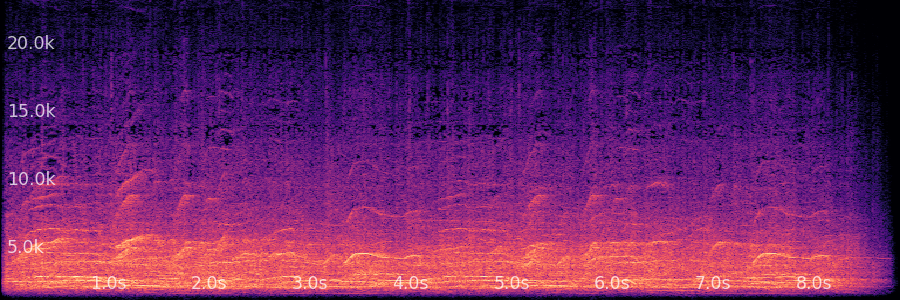
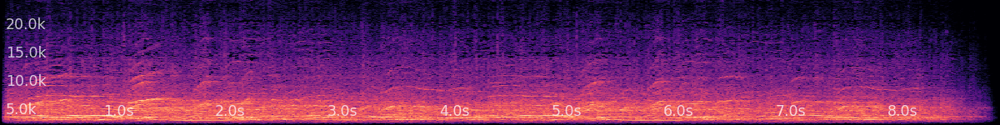

In [163]:
AudioSignal("octave_0.5.wav").widget()